
# Introduction
In dynamical systems, the phase space is the set of all possible states of the system (e.g., position–velocity pairs). A bounded subset of phase space is simply a region that fits inside some finite “ball” (so trajectories staying inside it never run off to infinity). This is the clean mathematical way to say “the motion remains confined.”

## **A Metric-Space Viewpoint**

Let $(X,d)$ be a **metric space** (this is the axiomatic setting: a set $X$ with a distance function $d$ satisfying the metric axioms). A subset $S \subseteq X $ is **bounded** if

$$\exists x_0\in X,\ \exists R>0\ \text{such that}\ S\subseteq B(x_0,R):=\{x\in X:\ d(x,x_0)<R\}.$$

**Special case (phase space):** Often $X=\mathbb{R}^n$  with a norm $\|\cdot\|$ and metric $d(x,y)=\|x-y\|$. Then $S$ is bounded iff

$$
\exists R>0\ :\ \|x\|\le R \;\forall\; x\in S
$$

> 📌 **Note (Bounded Subset of a Metric Space)**
>
> Let $(X,d)$ be a metric space and $S \subseteq X$. The set $S$ is said to be **bounded** if and only if
> $$\exists\, x_0 \in X,\ \exists\, R>0 \ \text{such that} \ \forall x \in S,\ d(x,x_0) \le R.$$
>
> **Equivalently**, $\exists R>0 : S \subseteq \overline{B}(x_0,R).$

### $ \S. \textbf{Proposition.}$

If $S\subseteq X$ is bounded, then for every $y\in X$ there exists $M>0$ such that

$$
d(x,y)\le M\quad \forall x\in S.
$$

**Proof.** Since $S$ is bounded, $\exists x_0\in X,\exists R>0$ with $d(x,x_0)\le R\; \forall x\in S$. Fix any $y\in X$. By the triangle inequality,

$$
d(x,y)\le d(x,x_0)+d(x_0,y)\le R+d(x_0,y)\quad \forall x\in S.
$$

So take $M:=R+d(x_0,y)$

*Interpretation:* once a set fits inside one ball, it fits inside a ball centered anywhere (with a possibly larger radius).

## **Normed Phase Space($X= \mathbb{R}^n$)**

Let $\|\cdot\|$ be any norm and $d(x,y)=\|x-y\|$.

**Corollary:**  $S\subseteq \mathbb{R}^n$ is bounded iff $\displaystyle \sup_{x\in S}\|x\|<\infty$ (equivalently, $\exists M>0$ with $\|x\|\le M\ \;\forall x\in S$.)

**Proof:**

If $\|x\|\le M\ \;\forall x\in S$, then $S\subseteq \overline{B}(0,M)$ bounded.

If $S\subseteq \overline{B}(x_0,R)$, then by triangle inequality,

$$
\|x\|\le \|x-x_0\|+\|x_0\|\le R+\|x_0\|\quad \forall x\in S,
$$

so, $\displaystyle \sup_{x\in S}\|x\|< R+\|x_0\|<\infty$.

# A Bounded Region in The Phase Plane

Consider the damped harmonic oscilator written as a first order system on phase space $\mathbb{R}^2$

System:

$$
\dot x=y,\qquad \dot y=-x-y.
$$

Here the phase space point is $z = (x,y)$

Now, to prove trajectories stay in bounded subset, we define the energy like function (Essentially, a Lyapunov Function)

$$
V(x,y)=x^2+y^2.
$$

Along a trajectory $(x(t),y(t)),$ the function becomes

$$
V(t)=V(x(t),y(t))=x(t)^2+y(t)^2.
$$

Since $V$ depends on $t$ through $x(t)$ and $y(t),$ we differentiate using chain rule, 

$$\dot V(t)=\frac{d}{dt}\big(x(t)^2+y(t)^2\big).$$

-    $\frac{d}{dt}(x(t)^2)=2x(t)\,\dot x(t)$

-   $\frac{d}{dt}(y(t)^2)=2y(t)\,\dot y(t)$

So, $\dot V = 2x\dot x + 2y\dot y.$ Equivalently (same thing, just in multivariable form):

$$\dot V = V_x \dot x + V_y \dot y, \quad\text{where}\quad V_x=2x,\; V_y=2y.
$$

From the system $\dot x = y,\; \dot y = -x-y.$ Plug these into $\dot V = 2x\dot x + 2y\dot y:$

$$
\dot V = 2x(y) + 2y(-x-y)= 2xy - 2xy - 2y^2 = -2y^2 \le 0 \quad( \text{As,}\; \forall\; y \in \mathbb{R}\; ,y^2 \ge 0) 
$$

So, $V(t)$ is a non-increasing function. Hence,

$$
\forall t\ge 0,\;
V(t)\le V(0)\quad\implies\quad x(t)^2+y(t)^2\le x(0)^2+y(0)^2. \text{where}\; t \in \mathbb{R}
$$
This shows every trajectory starting at $z_0 = (x(0),y(0))$ remains inside the closed ball

$$ \boxed{\ \{(x,y)\in\mathbb{R}^2:\ x^2+y^2 \le x(0)^2+y(0)^2\}\ } $$

which is a **bounded subset of phase space**.




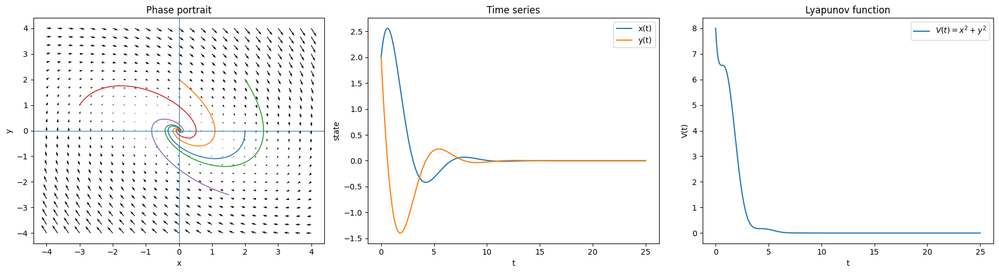

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

# Damped harmonic oscillator: x' = y, y' = -x - y
def f(t, z):
    x, y = z
    return np.array([y, -x - y], dtype=float)

def rk4(f, t0, z0, h, n):
    z0 = np.asarray(z0, dtype=float)

    t = np.empty(n + 1)
    z = np.empty((n + 1, len(z0)))

    t[0] = t0
    z[0] = z0

    for k in range(n):
        tk = t[k]
        zk = z[k]

        k1 = f(tk, zk)
        k2 = f(tk + h/2, zk + h*k1/2)
        k3 = f(tk + h/2, zk + h*k2/2)
        k4 = f(tk + h, zk + h*k3)

        z[k+1] = zk + (h/6)*(k1 + 2*k2 + 2*k3 + k4)
        t[k+1] = tk + h

    return t, z

# --------------------------------------------------
# Simulation
# --------------------------------------------------
T = 25.0
h = 0.01
n = int(T/h)

inits = [
    np.array([2.0, 0.0]),
    np.array([0.0, 2.0]),
    np.array([2.0, 2.0]),
    np.array([-3.0, 1.0]),
    np.array([1.5, -2.5]),
]

trajectories = []
for z0 in inits:
    t, z = rk4(f, 0.0, z0, h, n)
    trajectories.append((t, z))

# Vector field
xg = np.linspace(-4, 4, 25)
yg = np.linspace(-4, 4, 25)
X, Y = np.meshgrid(xg, yg)
U = Y
V = -X - Y

# Pick one trajectory for time-series
t, z = trajectories[2]
x, y = z[:, 0], z[:, 1]
lyap = x**2 + y**2

# --------------------------------------------------
# Row layout: 1 × 3
# --------------------------------------------------
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# --- (1) Phase portrait ---
ax = axes[0]
ax.quiver(X, Y, U, V, angles="xy", scale_units="xy", scale=25)
for _, z in trajectories:
    ax.plot(z[:, 0], z[:, 1], linewidth=1.2)
ax.axhline(0, linewidth=0.8)
ax.axvline(0, linewidth=0.8)
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title("Phase portrait")

# --- (2) Time series ---
ax = axes[1]
ax.plot(t, x, label="x(t)")
ax.plot(t, y, label="y(t)")
ax.set_xlabel("t")
ax.set_ylabel("state")
ax.set_title("Time series")
ax.legend()

# --- (3) Lyapunov function ---
ax = axes[2]
ax.plot(t, lyap, label=r"$V(t)=x^2+y^2$")
ax.set_xlabel("t")
ax.set_ylabel("V(t)")
ax.set_title("Lyapunov function")
ax.legend()

plt.tight_layout()
plt.show()


# 2-D Expanding Sphere Centered at y(t)
## **The 2-D Animation**
Once You'll Press the Play button 

- $S$ stays fixed.

- The original circle around $x_0$​ stays fixed.

- The new center $y(t)$ moves.

- The dashed circle radius becomes $R+\|x_0-y(t)\|$ and always covers $S$.

In [ ]:
import numpy as np
import plotly.graph_objects as go

# ----------------------------
# Generate a bounded set S in R^2
# ----------------------------
np.random.seed(7)
n = 250
S = np.random.normal(size=(n, 2))
S[:, 0] = 0.8*S[:, 0] + 0.3*np.sin(3*S[:, 1])
S[:, 1] = 0.6*S[:, 1] + 0.2*np.cos(2*S[:, 0])

# Choose an "old center" x0 and minimal radius R that covers S (closed ball)
x0 = np.array([0.2, -0.1])
d0 = np.linalg.norm(S - x0, axis=1)
R  = d0.max()  # so S ⊆ closed ball centered at x0 radius R

# Moving new center y(t) along a path
T = 80
theta = np.linspace(0, 2*np.pi, T)
y_path = np.c_[2.5*np.cos(theta)+1.2, 1.8*np.sin(theta)-0.7]

# Circle parametrization
def circle_points(center, rad, m=300):
    ang = np.linspace(0, 2*np.pi, m)
    return center[0] + rad*np.cos(ang), center[1] + rad*np.sin(ang)

# Precompute original circle
cx0, cy0 = circle_points(x0, R)

# Plot limits (nice padding)
all_pts = np.vstack([S, y_path, x0[None,:]])
xmin, ymin = all_pts.min(axis=0) - 3.0
xmax, ymax = all_pts.max(axis=0) + 3.0

# Initial frame (t=0)
y0 = y_path[0]
r_new0 = R + np.linalg.norm(x0 - y0)  # R + d(x0,y)
cynx, cyny = circle_points(y0, r_new0)

fig = go.Figure(
    data=[
        # Set S
        go.Scatter(x=S[:,0], y=S[:,1], mode="markers", name="Set S",
                   marker=dict(size=6, opacity=0.75)),
        # Old center x0
        go.Scatter(x=[x0[0]], y=[x0[1]], mode="markers+text",
                   name="Old center x0", text=["x0"], textposition="top center",
                   marker=dict(size=12, symbol="x")),
        # Old ball boundary
        go.Scatter(x=cx0, y=cy0, mode="lines", name="Ball B(x0,R)",
                   line=dict(width=3)),
        # New center y
        go.Scatter(x=[y0[0]], y=[y0[1]], mode="markers+text",
                   name="New center y", text=["y"], textposition="top center",
                   marker=dict(size=12)),
        # New (expanded) ball boundary
        go.Scatter(x=cynx, y=cyny, mode="lines",
                   name="Ball B(y, R + d(x0,y))", line=dict(width=3, dash="dash")),
    ],
    layout=go.Layout(
        title="2D: Center does not matter — expanding circle centered at y(t)",
        xaxis=dict(range=[xmin, xmax], zeroline=False, scaleanchor="y", scaleratio=1),
        yaxis=dict(range=[ymin, ymax], zeroline=False),
        width=850, height=650,
        updatemenus=[dict(
            type="buttons", showactive=False,
            buttons=[
                dict(label="Play", method="animate",
                     args=[None, dict(frame=dict(duration=60, redraw=True),
                                      transition=dict(duration=0),
                                      fromcurrent=True, mode="immediate")]),
                dict(label="Pause", method="animate",
                     args=[[None], dict(frame=dict(duration=0, redraw=False),
                                        transition=dict(duration=0),
                                        mode="immediate")]),
            ],
        )]
    )
)

# Build animation frames
frames = []
for k in range(T):
    y = y_path[k]
    r_new = R + np.linalg.norm(x0 - y)
    cx, cy = circle_points(y, r_new)

    # Optional: show triangle-inequality "route" x -> x0 -> y for one extreme point
    x_star = S[np.argmax(np.linalg.norm(S - x0, axis=1))]
    seg1x, seg1y = [x_star[0], x0[0]], [x_star[1], x0[1]]
    seg2x, seg2y = [x0[0], y[0]], [x0[1], y[1]]

    frames.append(go.Frame(
        data=[
            go.Scatter(x=S[:,0], y=S[:,1], mode="markers"),
            go.Scatter(x=[x0[0]], y=[x0[1]], mode="markers+text"),
            go.Scatter(x=cx0, y=cy0, mode="lines"),
            go.Scatter(x=[y[0]], y=[y[1]], mode="markers+text"),
            go.Scatter(x=cx, y=cy, mode="lines"),

            # two helper segments to visually emphasize triangle inequality
            go.Scatter(x=seg1x, y=seg1y, mode="lines", showlegend=False,
                       line=dict(width=2)),
            go.Scatter(x=seg2x, y=seg2y, mode="lines", showlegend=False,
                       line=dict(width=2)),
        ],
        name=str(k)
    ))

# Add the helper segment traces to the initial figure (so frames can update them)
fig.add_trace(go.Scatter(x=[np.nan], y=[np.nan], mode="lines",
                         showlegend=False, line=dict(width=2)))
fig.add_trace(go.Scatter(x=[np.nan], y=[np.nan], mode="lines",
                         showlegend=False, line=dict(width=2)))

fig.frames = frames
fig.show()


### Explanation About the Diagram

1.   **The bounded set** $S$

-   Drawn as a scattered cloud of points (or a small irregular blob).

-   This is your phase-space set (e.g., trajectory segment, invariant region)

2.   **Original ball** $B(x_0,R)$
 - A circle centered at $x_0$​ that fully contains $S$. 
 - This certifies boundedness.

3.   **New center** $y$
 - Chosen arbitrarily (can be far away) 
 - No assumption about $y$ relative to $S$.

4.   **Larger ball** $B(y, R + d(x_0,y))$
-   A bigger circle centered at $y$.
-   Still contains the entire set $S$

### Triangle inequality encoded visually

For any point $x \in S$:

-   The segment $x \to x_0$​ has length $\le R$

-   The segment $x_0 \to y$ has length $d(x_0,y)$.

-   The direct segment $x \to y$ is **shorter than or equal to their sum**

So geometrically:

$$
\boxed{\text{distance from } x \text{ to } y \;\le\; \text{distance to old center} + \text{shift of center}}
$$

That's why the radius grows by exactly $d(x_0,y)$.
## 3-D Expanding Sphere Centered at y(t)

In [1]:
import numpy as np
import plotly.graph_objects as go

# ----------------------------
# Generate a bounded set S in R^3
# ----------------------------
np.random.seed(11)
n = 350
S = np.random.normal(size=(n, 3))
S[:,0] = 0.9*S[:,0] + 0.15*np.sin(2*S[:,1])
S[:,1] = 0.7*S[:,1] + 0.20*np.cos(2*S[:,2])
S[:,2] = 0.6*S[:,2] + 0.10*np.sin(3*S[:,0])

# Old center x0 and radius R
x0 = np.array([0.1, -0.2, 0.15])
R  = np.linalg.norm(S - x0, axis=1).max()

# Moving center y(t)
T = 60
t = np.linspace(0, 2*np.pi, T)
y_path = np.c_[2.6*np.cos(t)+1.0, 1.9*np.sin(t)-0.5, 1.2*np.sin(2*t)+0.2]

# Sphere mesh
def sphere_mesh(center, rad, nu=30, nv=20):
    u = np.linspace(0, 2*np.pi, nu)
    v = np.linspace(0, np.pi, nv)
    uu, vv = np.meshgrid(u, v)
    X = center[0] + rad*np.cos(uu)*np.sin(vv)
    Y = center[1] + rad*np.sin(uu)*np.sin(vv)
    Z = center[2] + rad*np.cos(vv)
    return X, Y, Z

# Initial sphere surfaces
X0, Y0, Z0 = sphere_mesh(x0, R)
y0 = y_path[0]
r_new0 = R + np.linalg.norm(x0 - y0)
Xn, Yn, Zn = sphere_mesh(y0, r_new0)

# Plot bounds
mins = np.minimum(S.min(axis=0), np.vstack([y_path, x0]).min(axis=0)) - 3
maxs = np.maximum(S.max(axis=0), np.vstack([y_path, x0]).max(axis=0)) + 3

fig = go.Figure(
    data=[
        go.Scatter3d(x=S[:,0], y=S[:,1], z=S[:,2], mode="markers",
                     name="Set S", marker=dict(size=3, opacity=0.7)),
        go.Scatter3d(x=[x0[0]], y=[x0[1]], z=[x0[2]], mode="markers+text",
                     name="Old center x0", text=["x0"], textposition="top center",
                     marker=dict(size=6, symbol="x")),
        go.Surface(x=X0, y=Y0, z=Z0, name="Ball B(x0,R)", opacity=0.18, showscale=False),
        go.Scatter3d(x=[y0[0]], y=[y0[1]], z=[y0[2]], mode="markers+text",
                     name="New center y", text=["y"], textposition="top center",
                     marker=dict(size=6)),
        go.Surface(x=Xn, y=Yn, z=Zn, name="Ball B(y, R + d(x0,y))",
                   opacity=0.12, showscale=False),
    ],
    layout=go.Layout(
        title="3D: Center does not matter — expanding sphere centered at y(t)",
        width=900, height=700,
        scene=dict(
            xaxis=dict(range=[mins[0], maxs[0]]),
            yaxis=dict(range=[mins[1], maxs[1]]),
            zaxis=dict(range=[mins[2], maxs[2]]),
            aspectmode="cube"
        ),
        updatemenus=[dict(
            type="buttons", showactive=False,
            buttons=[
                dict(label="Play", method="animate",
                     args=[None, dict(frame=dict(duration=80, redraw=True),
                                      transition=dict(duration=0),
                                      fromcurrent=True, mode="immediate")]),
                dict(label="Pause", method="animate",
                     args=[[None], dict(frame=dict(duration=0, redraw=False),
                                        transition=dict(duration=0),
                                        mode="immediate")]),
            ],
        )]
    )
)

frames = []
for k in range(T):
    y = y_path[k]
    r_new = R + np.linalg.norm(x0 - y)
    Xn, Yn, Zn = sphere_mesh(y, r_new)

    frames.append(go.Frame(
        data=[
            go.Scatter3d(x=S[:,0], y=S[:,1], z=S[:,2], mode="markers"),
            go.Scatter3d(x=[x0[0]], y=[x0[1]], z=[x0[2]], mode="markers+text"),
            go.Surface(x=X0, y=Y0, z=Z0, opacity=0.18, showscale=False),
            go.Scatter3d(x=[y[0]], y=[y[1]], z=[y[2]], mode="markers+text"),
            go.Surface(x=Xn, y=Yn, z=Zn, opacity=0.12, showscale=False),
        ],
        name=str(k)
    ))

fig.frames = frames
fig.show()


### Changes in 3D

Nothing conceptually — only geometry.

1. **Set** $S$

- A small 3D cluster (think of a strange attractor chunk or numerical orbit).

2. **Original bounding sphere**
-   Center $x_0$​, radius $R.$
-   Encloses the full dynamics.

3. **New arbitrary center** $y$

-   Could be outside, above, or far from the original sphere.

4. **Expanded sphere**

-   Radius $R + \|x_0 - y\|.$

-   Again, fully contains $S.$

**So boundedness is a global property, not tied to a specific origin.**


### How the Numerical Experiment Matches The Theorem

In the code, the “set” is not abstract—it is a computed trajectory:

$$
S_N=\{z_0,z_1,\dots,z_N\}\subseteq \mathbb{R}^m,
$$

where $z_k\approx z(t_k)$ for an ODE solution.

- **Metric is Euclidean:** $d(u,v)=\|u-v\|_2.$
- We choose a reference center  $x_0$​ (in 2D we used $0$ in 3D Lorenz we used the sample mean).
- **We define the computed radius** $R_N := \max_{0\le k\le N}\|z_k-x_0\|.$

Then, for every moving center $y(t)$ (your animated point),

$$
\boxed{\ \|z_k-y\|\le R_N + \|x_0-y\|\ \ \text{for all }k\ }
$$

which is exactly the theorem with $S=S_N​$ and $R=R_N​$.

The Animation Shows
> - The fixed ball $B(x_0,R_N)$ encloses the computed set $S_N$​.
> - As $y$ moves, the radius updates to $R_N+\|x_0-y\|$, guaranteeing the new ball contains all points $z_k$​.

### Rigorous Link to ODE Theory: Why $S=\{z(t):t\in[0,T]\}$ is bounded

The theorem needs a bounded set $S$. For ODE trajectories, boundedness is usually justified by either:

#### Continuity on a compact interval (very general)

Let $z:[0,T]\to \mathbb{R}^m$ be any continuous function (solutions of ODEs are $C^1$ hence continuous). Then $z([0,T])$ is compact, hence bounded.

>📌 **Proof sketch (rigorous):**
> - $[0,T]$ is compact.
> - Continuous image of a compact set is compact.
> - Compact subsets of $\mathbb{R}^m$ are bounded. So $S={z(t):t\in[0,T]}$ is bounded. 

This justifies boundedness for finite-time trajectories (which is exactly what you simulate). For specific systems (like your damped oscillator) one can prove boundedness and decay for all $t\ge 0$ via a Lyapunov function.

## Significance in Dynamical Systems 

-   **Phase Space Analysis**: bounded trajectories remain bounded regardless of coordinate shift.

-   **Lyapunov Methods**: energy bounds don’t depend on choosing the origin.

-   **Attractors**: absorbing balls can be centered anywhere.

-    **Numerics**: stability estimates are invariant under translation.

>  - Once a set fits inside one ball, any other center can cover it too — the price is only an increase in radius equal to the shift of centers.
>  - *Boundedness is not about where you stand — it’s about how far the set can stretch.*

Below are **Plotly animations** where the set $S$ is **not random points**, but a **numerically computed trajectory** from an ODE:

-    **2D:** damped oscillator in the phase plane $(x,y)$.

-    **3D:** Lorenz system in state space $(x,y,z)$

In both cases we animate a moving center $y(t)$ and the **guaranteed containing ball.**

$$
\overline{B}\bigl(y(t),\ R + d(x_0,y(t))\bigr), \quad \text{where } R = \sup_{x\in S} d(x,x_0).
$$

## 2D (Damped oscillator) — Trajectory as $𝑆$ Moving Center, Expanding Circle

In [5]:
import numpy as np
import plotly.graph_objects as go

# -----------------------------
# ODE: damped oscillator
# x' = y, y' = -x - y
# -----------------------------
def f(t, z):
    x, y = z
    return np.array([y, -x - y], dtype=float)

def rk4(f, t0, z0, h, n):
    t = np.empty(n+1)
    z = np.empty((n+1, len(z0)))
    t[0], z[0] = t0, z0
    for k in range(n):
        tk, zk = t[k], z[k]
        k1 = f(tk, zk)
        k2 = f(tk + h/2, zk + h*k1/2)
        k3 = f(tk + h/2, zk + h*k2/2)
        k4 = f(tk + h,   zk + h*k3)
        z[k+1] = zk + (h/6)*(k1 + 2*k2 + 2*k3 + k4)
        t[k+1] = tk + h
    return t, z

# ---- compute trajectory S
T  = 25.0
h  = 0.01
n  = int(T/h)
z0 = np.array([2.0, 1.0])
t, Z = rk4(f, 0.0, z0, h, n)
S = Z  # S is the trajectory points in phase space

# ---- choose old center x0 and radius R covering S
x0 = np.array([0.0, 0.0])  # convenient "reference center"
R  = np.linalg.norm(S - x0, axis=1).max()  # S ⊆ B̄(x0,R)

# ---- moving new center y(t) along a loop
framesN = 90
theta = np.linspace(0, 2*np.pi, framesN)
y_path = np.c_[2.2*np.cos(theta) + 1.2, 1.6*np.sin(theta) - 0.8]

def circle(center, rad, m=300):
    ang = np.linspace(0, 2*np.pi, m)
    return center[0] + rad*np.cos(ang), center[1] + rad*np.sin(ang)

# original bounding circle around x0
cx0, cy0 = circle(x0, R)

# axes range
all_pts = np.vstack([S, y_path, x0[None,:]])
xmin, ymin = all_pts.min(axis=0) - 1.5
xmax, ymax = all_pts.max(axis=0) + 1.5

# initial frame
y_init = y_path[0]
r_new  = R + np.linalg.norm(x0 - y_init)
cynx, cyny = circle(y_init, r_new)

fig = go.Figure(
    data=[
        go.Scatter(x=S[:,0], y=S[:,1], mode="lines", name="Trajectory S (ODE)",
                   line=dict(width=3)),
        go.Scatter(x=[x0[0]], y=[x0[1]], mode="markers+text",
                   name="Old center x0", text=["x0"], textposition="top center",
                   marker=dict(size=12, symbol="x")),
        go.Scatter(x=cx0, y=cy0, mode="lines", name="Ball B(x0,R)",
                   line=dict(width=3)),
        go.Scatter(x=[y_init[0]], y=[y_init[1]], mode="markers+text",
                   name="New center y(t)", text=["y"], textposition="top center",
                   marker=dict(size=12)),
        go.Scatter(x=cynx, y=cyny, mode="lines",
                   name="Ball B(y, R + d(x0,y))", line=dict(width=3, dash="dash")),
    ],
    layout=go.Layout(
        title=f"2D ODE trajectory as S:  R={R:.3f}.  New radius = R + d(x0,y(t))",
        xaxis=dict(range=[xmin, xmax], scaleanchor="y", scaleratio=1, zeroline=False),
        yaxis=dict(range=[ymin, ymax], zeroline=False),
        width=850, height=650,
        updatemenus=[dict(
            type="buttons", showactive=False,
            buttons=[
                dict(label="Play", method="animate",
                     args=[None, dict(frame=dict(duration=60, redraw=True),
                                      transition=dict(duration=0),
                                      fromcurrent=True, mode="immediate")]),
                dict(label="Pause", method="animate",
                     args=[[None], dict(frame=dict(duration=0, redraw=False),
                                        transition=dict(duration=0),
                                        mode="immediate")]),
            ],
        )]
    )
)

# build frames
frames = []
for k in range(framesN):
    y = y_path[k]
    r_new = R + np.linalg.norm(x0 - y)
    cx, cy = circle(y, r_new)

    frames.append(go.Frame(
        data=[
            go.Scatter(x=S[:,0], y=S[:,1], mode="lines"),
            go.Scatter(x=[x0[0]], y=[x0[1]], mode="markers+text"),
            go.Scatter(x=cx0, y=cy0, mode="lines"),
            go.Scatter(x=[y[0]], y=[y[1]], mode="markers+text"),
            go.Scatter(x=cx, y=cy, mode="lines"),
        ],
        name=str(k),
        layout=go.Layout(
            title=f"2D: R={R:.3f}, d(x0,y)={np.linalg.norm(x0-y):.3f}, new radius={r_new:.3f}"
        )
    ))

fig.frames = frames
fig.show()


The ODE trajectory $S={(x(t),y(t))}$ is bounded by $B(x_0,R)$. As the center moves to $y(t)$ the dashed circle radius automatically updates to $R+∥x_0−y(t)∥$ and still contains the entire trajectory set.

System:

$$
\dot x=y,\qquad \dot y=-x-y.
$$

Let

$$
V(x,y)=x^2+y^2.
$$

Then along solutions:

$$
\dot V = 2x\dot x+2y\dot y = 2xy + 2y(-x-y) = -2y^2\le 0.
$$

Therefore,

$$
V(t)\le V(0)\quad\implies\quad x(t)^2+y(t)^2\le x(0)^2+y(0)^2.
$$

### Interpretation in phase space

The **entire trajectory** lies in the disk:

$$
S_{\infty}:=\{(x(t),y(t)):t\ge 0\}\subseteq \overline{B}\Bigg(0,\sqrt{V(0)}\Bigg).
$$

So boundedness is not just numerical—it is **proved**.

Then apply “center does not matter”

For any $y\in\mathbb{R}^2$,

$$
S_{\infty}\subseteq \overline{B}\Bigg(y,\ \sqrt{V(0)}+\|y\|\Bigg).
$$

This is the exact inequality animation encodes (with $x_0=0$, $R=\sqrt{V(0)}$​ or its sampled version $R_N$​).

> 📌 **Note**: 
> Let $S_N = \{z_k\}_{k=0}^{N} \subset \mathbb{R}^m$ denote sampled states of a numerically integrated trajectory and fix $x_0 \in \mathbb{R}^m$. Define $\displaystyle R_N =\max_{k} \|z_k - x_0\|,$ so $S_N \subseteq \overline{B}(x_0, R_N).$ By the triangle inequality, for any $y \in \mathbb{R}^m$ and any $z_k \in S_N$ we have we have $\|z_k-y\|\le \|z_k-x_0\|+\|x_0-y\|\le R_N+\|x_0-y\|$. Hence, $S_N \subseteq \overline{B}(y, R_N + \| x_0 - y\|)$. The animations depict this containment as the center $y$ moves and the radius updates accordingly.



# 3-D(Lorenz)-Trajectory as $S$, Moving Centere, Expanding Sphere

In [6]:
import numpy as np
import plotly.graph_objects as go

# -----------------------------
# Lorenz system
# x' = σ(y-x)
# y' = x(ρ - z) - y
# z' = xy - βz
# -----------------------------
def lorenz(t, z, sigma=10.0, rho=28.0, beta=8.0/3.0):
    x, y, zz = z
    return np.array([
        sigma*(y - x),
        x*(rho - zz) - y,
        x*y - beta*zz
    ], dtype=float)

def rk4_vecfield(g, t0, z0, h, n):
    t = np.empty(n+1)
    z = np.empty((n+1, len(z0)))
    t[0], z[0] = t0, z0
    for k in range(n):
        tk, zk = t[k], z[k]
        k1 = g(tk, zk)
        k2 = g(tk + h/2, zk + h*k1/2)
        k3 = g(tk + h/2, zk + h*k2/2)
        k4 = g(tk + h,   zk + h*k3)
        z[k+1] = zk + (h/6)*(k1 + 2*k2 + 2*k3 + k4)
        t[k+1] = tk + h
    return t, z

# ---- simulate Lorenz trajectory
h = 0.01
T = 40.0
n = int(T/h)

z0 = np.array([1.0, 1.0, 1.0])
t, Z = rk4_vecfield(lambda tt, zz: lorenz(tt, zz), 0.0, z0, h, n)

# discard transient so S is the "attractor" part
burn = int(10.0/h)
S = Z[burn:]

# ---- choose old center x0 and radius R covering S
x0 = S.mean(axis=0)  # a natural reference center
R  = np.linalg.norm(S - x0, axis=1).max()

# ---- moving center y(t) in 3D
framesN = 70
theta = np.linspace(0, 2*np.pi, framesN)
y_path = np.c_[
    x0[0] + 25*np.cos(theta),
    x0[1] + 18*np.sin(theta),
    x0[2] + 12*np.sin(2*theta)
]

def sphere_mesh(center, rad, nu=40, nv=25):
    u = np.linspace(0, 2*np.pi, nu)
    v = np.linspace(0, np.pi, nv)
    uu, vv = np.meshgrid(u, v)
    X = center[0] + rad*np.cos(uu)*np.sin(vv)
    Y = center[1] + rad*np.sin(uu)*np.sin(vv)
    Z = center[2] + rad*np.cos(vv)
    return X, Y, Z

# original sphere around x0
X0, Y0, Z0s = sphere_mesh(x0, R)

# initial new sphere
y_init = y_path[0]
r_new  = R + np.linalg.norm(x0 - y_init)
Xn, Yn, Zn = sphere_mesh(y_init, r_new)

# bounds
mins = np.minimum(S.min(axis=0), np.vstack([y_path, x0]).min(axis=0)) - 10
maxs = np.maximum(S.max(axis=0), np.vstack([y_path, x0]).max(axis=0)) + 10

fig = go.Figure(
    data=[
        go.Scatter3d(x=S[:,0], y=S[:,1], z=S[:,2], mode="lines",
                     name="Trajectory S (Lorenz)", line=dict(width=2)),
        go.Scatter3d(x=[x0[0]], y=[x0[1]], z=[x0[2]], mode="markers+text",
                     name="Old center x0", text=["x0"], textposition="top center",
                     marker=dict(size=5, symbol="x")),
        go.Surface(x=X0, y=Y0, z=Z0s, name="Ball B(x0,R)",
                   opacity=0.14, showscale=False),
        go.Scatter3d(x=[y_init[0]], y=[y_init[1]], z=[y_init[2]], mode="markers+text",
                     name="New center y(t)", text=["y"], textposition="top center",
                     marker=dict(size=5)),
        go.Surface(x=Xn, y=Yn, z=Zn, name="Ball B(y, R + d(x0,y))",
                   opacity=0.10, showscale=False),
    ],
    layout=go.Layout(
        title=f"3D Lorenz trajectory as S: R={R:.2f}, new radius = R + d(x0,y(t))",
        width=950, height=750,
        scene=dict(
            xaxis=dict(range=[mins[0], maxs[0]]),
            yaxis=dict(range=[mins[1], maxs[1]]),
            zaxis=dict(range=[mins[2], maxs[2]]),
            aspectmode="cube"
        ),
        updatemenus=[dict(
            type="buttons", showactive=False,
            buttons=[
                dict(label="Play", method="animate",
                     args=[None, dict(frame=dict(duration=80, redraw=True),
                                      transition=dict(duration=0),
                                      fromcurrent=True, mode="immediate")]),
                dict(label="Pause", method="animate",
                     args=[[None], dict(frame=dict(duration=0, redraw=False),
                                        transition=dict(duration=0),
                                        mode="immediate")]),
            ],
        )]
    )
)

frames = []
for k in range(framesN):
    y = y_path[k]
    r_new = R + np.linalg.norm(x0 - y)
    Xn, Yn, Zn = sphere_mesh(y, r_new)

    frames.append(go.Frame(
        data=[
            go.Scatter3d(x=S[:,0], y=S[:,1], z=S[:,2], mode="lines"),
            go.Scatter3d(x=[x0[0]], y=[x0[1]], z=[x0[2]], mode="markers+text"),
            go.Surface(x=X0, y=Y0, z=Z0s, opacity=0.14, showscale=False),
            go.Scatter3d(x=[y[0]], y=[y[1]], z=[y[2]], mode="markers+text"),
            go.Surface(x=Xn, y=Yn, z=Zn, opacity=0.10, showscale=False),
        ],
        name=str(k),
        layout=go.Layout(
            title=f"3D: R={R:.2f}, d(x0,y)={np.linalg.norm(x0-y):.2f}, new radius={r_new:.2f}"
        )
    ))

fig.frames = frames
fig.show()


# Lorenz System 

$$\dot x=\sigma(y-x),\quad \dot y=x(\rho-z)-y,\quad \dot z=xy-\beta z.$$

For any **finite time** $T$, the solution exists and is continuous on $[0,T]$ (standard ODE existence–uniqueness, since RHS is smooth). Hence:

$$S_T=\{(x(t),y(t),z(t)):t\in[0,T]\}\ \text{is bounded}.$$

So the theorem applies to $S_T$​ exactly. We discarded a transient and used

$$
\displaystyle S_N=\{z(t_k)\}_{k=\text{burn}}^N
$$

as an approximation to a subset of the attractor. Then you computed

$$
R_N=\max_k \|z(t_k)-x_0\|.
$$

So the plotted “bounding spheres” are rigorous for the **discrete set** $S_N$​; and they are good approximations for the continuous set $S_T$​ when the step size is small.

> If we want a *global-in-time* Lorenz bound (absorbing ball), we can also derive a standard dissipativity estimate; but it’s a bit longer. Hence, the animation is already fully justified for the finite-time simulated set.


## The Lorenz flow

We study the autonomous ODE on $\mathbb{R}^3$:

$$
\dot{\mathbf{x}} = F(\mathbf{x}), \qquad \mathbf{x}=(x,y,z),
$$with the Lorenz vector field

$$
F(x,y,z)=\begin{pmatrix} \sigma (y-x)\\ x(\rho-z)-y\\ xy-\beta z \end{pmatrix}, \quad \sigma=10,\; \rho=28,\; \beta=\frac{8}{3}.
$$

A trajectory (orbit) is a function $\mathbf{x}(t)$ solving the IVP

$$
\mathbf{x}(0)=\mathbf{x}_0,\qquad \mathbf{x}'(t)=F(\mathbf{x}(t)).
$$

The attractor is not computed symbolically; instead we generate a long numerical orbit that approximates the invariant set.

## Numerical Discretization: RK4 as an Approximate Flow Map

The code uses classical 4th-order Runge–Kutta (RK4) to approximate $\mathbf{x}(t)$ on a grid.

Let $t_n=t_0+nh \; \text{with} \; h=(t_1-t_0)/N$. RK4 updates

$$
\mathbf{x}_{n+1}=\mathbf{x}_n+\frac{h}{6}\Big(k_1+2k_2+2k_3+k_4\Big)
$$

where,

$$
\begin{aligned} k_1&=F(\mathbf{x}_n),\\ k_2&=F(\mathbf{x}_n+\tfrac{h}{2}k_1),\\ k_3&=F(\mathbf{x}_n+\tfrac{h}{2}k_2),\\ k_4&=F(\mathbf{x}_n+h k_3). \end{aligned}
$$

Computational meaning: RK4 is approximating the flow map $\varphi_h​$ (time-$h$ evolution operator) by a 4th-order method:

- Local truncation error: $O(h^5)$. 

- Global error over a fixed time interval: $O(h^4)$.

- For chaotic systems, errors eventually amplify, but RK4 still produces a statistically and geometrically faithful orbit for visualization over moderate horizons.

## The Geometric Containment Certificate ( What $\Delta$ is Measuring ) 

We create a long discrete orbit

$$
S_N=\{\mathbf{x}(t_0),\mathbf{x}(t_1),\dots,\mathbf{x}(t_N)\}\subset\mathbb{R}^3.
$$

Fix a reference point $\mathbf{x}_0=(0,0,0)$. Define

$$
R=\max_{0\le n\le N}\|\mathbf{x}(t_n)-\mathbf{x}_0\|.
$$Then by definition,

$$
S_N\subset \overline{B}(\mathbf{x}_0,R).
$$

Now pick a moving center $\mathbf{y}(t)$ that lies on the trajectory itself (the code uses sampled frames):

$$
\mathbf{y}_i=\mathbf{x}(t_i^{\text{frame}})
$$

A basic inequality in normed spaces (triangle inequality) gives for any point $\mathbf{p}\in S_N​:$

$$
\|\mathbf{p}-\mathbf{y}\| \le \|\mathbf{p}-\mathbf{x}_0\|+\|\mathbf{x}_0-\mathbf{y}\| \le R+\|\mathbf{x}_0-\mathbf{y}\|.
$$

Therefore,

$$
S_N \subset \overline{B}\!\left(\mathbf{y},\, R+\|\mathbf{x}_0-\mathbf{y}\|\right).
$$

## Why compute $\Delta(\mathbf{y})$?

Numerically, we verify (and quantify) how tight that inclusion is by defining

$$\Delta(\mathbf{y}) = \max_{\mathbf{p}\in S_N} \left( \|\mathbf{p}-\mathbf{y}\| - \big(R+\|\mathbf{x}_0-\mathbf{y}\|\big) \right).$$

Interpretation:

- If $\Delta(\mathbf{y})\le 0$, then every $\mathbf{p}\in S_N$ satisfies $\|\mathbf{p}-\mathbf{y}\|\le R+\|\mathbf{x}_0-\mathbf{y}\|$  i.e. the inclusion holds (certificate passes).

- If $\Delta(\mathbf{y})>0$, the bound fails for at least one point (certificate fails).

In exact arithmetic with exact $R$, the triangle inequality implies $\Delta(\mathbf{y})\le 0$ always. In computation, you can still see small numerical deviations due to: 

- Discretization of the orbit (finite set),
- Floating point error, 
- Sampling mismatch between how $R$ is computed and how $\mathbf{y}$ is sampled.

> So the $\Delta$-plot is a live numerical sanity-check.



In [23]:
# ============================================================
# Moving-center containment in 3D (Lorenz) with live Δ(y(t))
# CLEAN wide-screen visualization (NO SLIDER):
#  - Tail grows + highlighted head segment
#  - Moving point y(t) synchronized
#  - Δ-plot with moving dot + vertical time cursor (replaces slider)
#  - Slow camera orbit (multi-angle view)
#  - 800 frames, 80 ms/frame (lecture-quality pacing)
#  - Works in VS Code (local) + Colab
#  - HTML export includes MathJax for LaTeX rendering
# ============================================================

import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import os, zipfile, sys

# ------------------------------------------------------------
# 0) Environment helpers
# ------------------------------------------------------------
def in_colab():
    return "google.colab" in sys.modules

def ensure_kaleido():
    """
    Tries to ensure kaleido exists for PNG export.
    - In Colab: installs via %pip (through IPython)
    - Locally: returns False with instruction
    """
    try:
        import kaleido  # noqa: F401
        return True, None
    except Exception as e:
        if in_colab():
            try:
                from IPython import get_ipython
                ip = get_ipython()
                ip.run_line_magic("pip", "install -U kaleido")
                import kaleido  # noqa: F401
                return True, None
            except Exception as ee:
                return False, f"Colab install failed: {ee}"
        return False, "Kaleido missing. Install locally: pip install -U kaleido"

# ------------------------------------------------------------
# 1) Portable output directory (local + Colab)
# ------------------------------------------------------------
base_dir = "/content" if in_colab() else os.path.abspath(os.getcwd())
out_dir = os.path.join(base_dir, "moving_center_3d_exports")
os.makedirs(out_dir, exist_ok=True)

AUTO_OPEN_HTML = (not in_colab())

# ------------------------------------------------------------
# 2) Lorenz + RK4
# ------------------------------------------------------------
def lorenz(state, sigma=10.0, rho=28.0, beta=8.0/3.0):
    x, y, z = state
    return np.array([
        sigma * (y - x),
        x * (rho - z) - y,
        x * y - beta * z
    ], dtype=float)

def rk4(f, y0, t0, t1, n_steps):
    y = np.zeros((n_steps + 1, len(y0)), dtype=float)
    t = np.linspace(t0, t1, n_steps + 1, dtype=float)
    y[0] = np.array(y0, dtype=float)
    dt = (t1 - t0) / n_steps
    for i in range(n_steps):
        k1 = f(y[i])
        k2 = f(y[i] + 0.5 * dt * k1)
        k3 = f(y[i] + 0.5 * dt * k2)
        k4 = f(y[i] + dt * k3)
        y[i+1] = y[i] + (dt/6.0) * (k1 + 2*k2 + 2*k3 + k4)
    return t, y

t0, t1 = 0.0, 40.0
n_steps = 16000  # dense trajectory for smoother tail growth
t, traj = rk4(lorenz, y0=[1.0, 1.0, 1.0], t0=t0, t1=t1, n_steps=n_steps)

# ------------------------------------------------------------
# 3) Frames: 800 (tail grows + moving dot)
# ------------------------------------------------------------
x0 = np.array([0.0, 0.0, 0.0], dtype=float)
R = float(np.max(np.linalg.norm(traj - x0, axis=1)))

n_frames = 800
frame_idx = np.linspace(0, len(traj) - 1, n_frames).astype(int)
t_frames = t[frame_idx]
ys = traj[frame_idx]

# Delta(y) per frame
Delta = np.empty(n_frames, dtype=float)
for i, y in enumerate(ys):
    lhs = np.linalg.norm(traj - y, axis=1)
    rhs = R + np.linalg.norm(x0 - y)
    Delta[i] = np.max(lhs - rhs)

ymin = float(np.min(Delta))
ymax = float(np.max(Delta))

# ------------------------------------------------------------
# 4) Sphere surface mesh
# ------------------------------------------------------------
u = np.linspace(0, 2*np.pi, 70)
v = np.linspace(0, np.pi, 40)
uu, vv = np.meshgrid(u, v)

def sphere_surface(center, radius):
    x = center[0] + radius*np.cos(uu)*np.sin(vv)
    y = center[1] + radius*np.sin(uu)*np.sin(vv)
    z = center[2] + radius*np.cos(vv)
    return x, y, z

sx0, sy0, sz0 = sphere_surface(x0, R)
y_init = ys[0]
R_new0 = R + np.linalg.norm(x0 - y_init)
syx, syy, syz = sphere_surface(y_init, R_new0)

# ------------------------------------------------------------
# 5) Camera orbit function (multi-angle view)
# ------------------------------------------------------------
def camera_orbit(i, n, radius=1.75, z=0.65):
    theta = 2*np.pi * (i / (n - 1))
    return dict(
        eye=dict(x=radius*np.cos(theta), y=radius*np.sin(theta), z=z),
        up=dict(x=0, y=0, z=1)
    )

# ------------------------------------------------------------
# 6) Build figure (CLEAN: no slider)
# ------------------------------------------------------------
fig = make_subplots(
    rows=1, cols=2,
    specs=[[{"type": "scene"}, {"type": "xy"}]],
    column_widths=[0.68, 0.32],
    horizontal_spacing=0.06
)

# Trace order (IMPORTANT):
# 0 full tail (thin)
# 1 head segment highlight (thick)
# 2 fixed sphere at x0
# 3 moving sphere around y(t)
# 4 marker x0
# 5 marker y(t)
# 6 Δ line
# 7 moving dot on Δ
# 8 zero line
# 9 vertical time cursor

# 0: tail
fig.add_trace(go.Scatter3d(
    x=traj[:1,0], y=traj[:1,1], z=traj[:1,2],
    mode="lines",
    line=dict(width=2),
    name=r"$S_N$"
), row=1, col=1)

# 1: head highlight
fig.add_trace(go.Scatter3d(
    x=traj[:1,0], y=traj[:1,1], z=traj[:1,2],
    mode="lines",
    line=dict(width=6),
    name="head"
), row=1, col=1)

# 2: fixed sphere
fig.add_trace(go.Surface(
    x=sx0, y=sy0, z=sz0,
    opacity=0.10,
    showscale=False,
    name=r"$\overline{B}(\mathbf{x}_0, R)$"
), row=1, col=1)

# 3: moving sphere (initial)
fig.add_trace(go.Surface(
    x=syx, y=syy, z=syz,
    opacity=0.10,
    showscale=False,
    name=r"$\overline{B}\!\left(\mathbf{y}, R+\|\mathbf{x}_0-\mathbf{y}\|\right)$"
), row=1, col=1)

# 4: x0 marker
fig.add_trace(go.Scatter3d(
    x=[x0[0]], y=[x0[1]], z=[x0[2]],
    mode="markers",
    marker=dict(size=5),
    name=r"$\mathbf{x}_0$"
), row=1, col=1)

# 5: y(t) marker
fig.add_trace(go.Scatter3d(
    x=[y_init[0]], y=[y_init[1]], z=[y_init[2]],
    mode="markers",
    marker=dict(size=7),
    name=r"$\mathbf{y}(t)$"
), row=1, col=1)

# 6: Delta line
fig.add_trace(go.Scatter(
    x=t_frames, y=Delta,
    mode="lines",
    name=r"$\Delta(\mathbf{y}(t))$"
), row=1, col=2)

# 7: moving dot on Δ
fig.add_trace(go.Scatter(
    x=[t_frames[0]], y=[Delta[0]],
    mode="markers",
    marker=dict(size=9,color="#003366"),
    name="current"
), row=1, col=2)

# 8: zero line
fig.add_trace(go.Scatter(
    x=[t_frames[0], t_frames[-1]], y=[0, 0],
    mode="lines",
    line=dict(width=1, dash="dash"),
    name=r"$0$"
), row=1, col=2)

# 9: vertical time cursor
fig.add_trace(go.Scatter(
    x=[t_frames[0], t_frames[0]],
    y=[ymin, ymax],
    mode="lines",
    line=dict(
        width=1.5,
        dash="dot",
        color="#003366"   # deep blue
    ),
    name="time"
), row=1, col=2)

# ---- Layout
fig.update_layout(
    title=dict(
        text=r"Moving-center containment (Lorenz) with live $\Delta(\mathbf{y}(t))$ certificate",
        x=0.5, xanchor="center"
    ),
    height=720,
    margin=dict(l=25, r=25, t=90, b=40),
    legend=dict(
        orientation="h",
        x=0.02, y=1.05,
        xanchor="left", yanchor="bottom",
        bgcolor="rgba(255,255,255,0.45)",
        font=dict(size=11)
    ),
)

# Axes titles
fig.update_scenes(
    row=1, col=1,
    xaxis_title=r"$x$",
    yaxis_title=r"$y$",
    zaxis_title=r"$z$",
    aspectmode="data"
)
fig.update_xaxes(title_text=r"$t$", row=1, col=2)
fig.update_yaxes(title_text=r"$\Delta(\mathbf{y}(t))$", row=1, col=2)

# Clean annotations
fig.add_annotation(
    x=0.18, y=1.03, xref="paper", yref="paper",
    showarrow=False,
    text=r"<b>3D phase space:</b> tail grows + moving $\mathbf{y}(t)$",
    font=dict(size=13)
)
fig.add_annotation(
    x=0.82, y=1.03, xref="paper", yref="paper",
    showarrow=False,
    text=r"<b>Certificate:</b> $\Delta(\mathbf{y}(t))$",
    font=dict(size=13)
)

# ------------------------------------------------------------
# 7) Frames: tail grows + head highlight + camera orbit
# ------------------------------------------------------------
HEAD_LEN = 120  # last N points highlighted

frames = []
for i in range(n_frames):
    j = frame_idx[i]
    y = ys[i]

    tail = traj[:j+1]
    j0 = max(0, j - HEAD_LEN)
    head = traj[j0:j+1]

    R_new = R + np.linalg.norm(x0 - y)
    sx, sy, sz = sphere_surface(y, R_new)

    cam = camera_orbit(i, n_frames, radius=1.75, z=0.65)

    frames.append(go.Frame(
        name=str(i),
        data=[
            go.Scatter3d(x=tail[:,0], y=tail[:,1], z=tail[:,2]),  # 0 tail
            go.Scatter3d(x=head[:,0], y=head[:,1], z=head[:,2]),  # 1 head
            go.Surface(),                                         # 2 fixed sphere unchanged
            go.Surface(x=sx, y=sy, z=sz),                         # 3 moving sphere
            go.Scatter3d(),                                       # 4 x0 unchanged
            go.Scatter3d(x=[y[0]], y=[y[1]], z=[y[2]]),           # 5 moving y(t)
            go.Scatter(),                                         # 6 Δ line unchanged
            go.Scatter(x=[t_frames[i]], y=[Delta[i]],mode="markers",marker=dict(size=9,color="#003366")),         # 7 moving dot on Δ
            go.Scatter(),                                         # 8 zero line unchanged
            go.Scatter( x=[t_frames[i], t_frames[i]], y=[ymin, ymax], mode="lines",
                        line=dict( width=1.5, dash="dot", color="#003366"   # deep blue
 )
),

        ],
        layout=go.Layout(
            title=dict(
                text=rf"Moving-center containment — $t={t_frames[i]:.2f}$,  $\Delta(\mathbf{{y}})={Delta[i]:.3e}$",
                x=0.5, xanchor="center"
            ),
            scene=dict(camera=cam)
        )
    ))
fig.frames = frames

# ------------------------------------------------------------
# 8) Controls: ONLY Play/Pause (no slider = no clumsiness)
# ------------------------------------------------------------
FRAME_DURATION_MS = 80
TRANSITION_MS = 0

fig.update_layout(
    updatemenus=[dict(
        type="buttons",
        direction="left",
        showactive=False,
        x=0.50, y=1.12,
        xanchor="center", yanchor="top",
        buttons=[
            dict(
                label="Play",
                method="animate",
                args=[None, dict(
                    frame=dict(duration=FRAME_DURATION_MS, redraw=True),
                    transition=dict(duration=TRANSITION_MS),
                    fromcurrent=True,
                    mode="immediate"
                )]
            ),
            dict(
                label="Pause",
                method="animate",
                args=[[None], dict(
                    frame=dict(duration=0, redraw=False),
                    transition=dict(duration=0),
                    mode="immediate"
                )]
            ),
        ]
    )]
)

# ------------------------------------------------------------
# 9) Export HTML with MathJax (LaTeX renders correctly)
# ------------------------------------------------------------
html_path = os.path.join(out_dir, "moving_center_3d_delta_live.html")
pio.write_html(
    fig,
    file=html_path,
    include_plotlyjs="cdn",
    include_mathjax="cdn",
    auto_open=AUTO_OPEN_HTML
)

# In notebooks you can also show with MathJax:
# fig.show(config={"mathjax":"cdn"})

# ------------------------------------------------------------
# 10) Optional: PNG export (can be heavy for 800 frames)
# ------------------------------------------------------------
EXPORT_PNG = False          # set True if you want PNG export
EXPORT_ALL_FRAMES = False   # set True to export all 800 frames (heavy)
EXPORT_EVERY = 10           # if not exporting all, export every Nth frame
ZIP_PNGS = True

png_dir = os.path.join(out_dir, "png_frames")
os.makedirs(png_dir, exist_ok=True)

png_paths = []
kaleido_ok = True
export_err = None
zip_path = None

if EXPORT_PNG:
    kaleido_ok, kaleido_err = ensure_kaleido()
    if not kaleido_ok:
        export_err = kaleido_err
    else:
        try:
            if EXPORT_ALL_FRAMES:
                selected = list(range(n_frames))
            else:
                selected = list(range(0, n_frames, EXPORT_EVERY))

            for idx in selected:
                fr = frames[idx]
                # apply frame data to figure for export
                fig.data[0].x, fig.data[0].y, fig.data[0].z = fr.data[0].x, fr.data[0].y, fr.data[0].z
                fig.data[1].x, fig.data[1].y, fig.data[1].z = fr.data[1].x, fr.data[1].y, fr.data[1].z
                fig.data[3].x, fig.data[3].y, fig.data[3].z = fr.data[3].x, fr.data[3].y, fr.data[3].z
                fig.data[5].x, fig.data[5].y, fig.data[5].z = fr.data[5].x, fr.data[5].y, fr.data[5].z
                fig.data[7].x, fig.data[7].y = fr.data[7].x, fr.data[7].y
                fig.data[9].x, fig.data[9].y = fr.data[9].x, fr.data[9].y
                fig.update_layout(title=fr.layout.title)

                p = os.path.join(png_dir, f"frame_{idx:04d}.png")
                pio.write_image(fig, p, scale=3, width=1800, height=760)
                png_paths.append(p)

            if ZIP_PNGS and png_paths:
                zip_path = os.path.join(out_dir, "paper_quality_frames.zip")
                with zipfile.ZipFile(zip_path, "w", compression=zipfile.ZIP_DEFLATED) as z:
                    for p in png_paths:
                        z.write(p, arcname=os.path.basename(p))

        except Exception as e:
            kaleido_ok = False
            export_err = str(e)

# ------------------------------------------------------------
# 11) Summary
# ------------------------------------------------------------
result = {
    "interactive_html": html_path,
    "kaleido_ok": kaleido_ok,
    "export_error_if_any": export_err,
    "frames_zip": zip_path,
    "output_directory": out_dir,
    "n_frames": n_frames,
    "frame_duration_ms": FRAME_DURATION_MS,
    "Delta_min": float(np.min(Delta)),
    "Delta_max": float(np.max(Delta)),
    "png_exported": len(png_paths),
}

print(result)
if EXPORT_PNG and (not kaleido_ok):
    print("\nPNG export skipped/failed:", export_err)
    print("Local fix: pip install -U kaleido")


{'interactive_html': 'c:\\Users\\maths\\AppData\\Local\\Programs\\Microsoft VS Code\\moving_center_3d_exports\\moving_center_3d_delta_live.html', 'kaleido_ok': True, 'export_error_if_any': None, 'frames_zip': None, 'output_directory': 'c:\\Users\\maths\\AppData\\Local\\Programs\\Microsoft VS Code\\moving_center_3d_exports', 'n_frames': 800, 'frame_duration_ms': 80, 'Delta_min': -53.51411033475975, 'Delta_max': -3.2393483625604347, 'png_exported': 0}


## What the Animation is Actually Showing

### (A) Tail Growth in Phase Space

As, each frame $i$ shows three coupled things. So, we display the polyline

$$
\{\mathbf{x}(t_0),\dots,\mathbf{x}(t_{j(i)})\}
$$

where $j(i)$ increases with the frame. That is the “tail grows”. To improve perception, you also draw a “head segment”

$$
\{\mathbf{x}(t_{j(i)-L}),\dots,\mathbf{x}(t_{j(i)})\}
$$

with larger line width. This makes motion readable: viewers see where the orbit currently is.

### (B) Moving Center $\mathbf{y}(t)$

The moving dot is exactly

$$
\mathbf{y}_i=\mathbf{x}(t^{\text{frame}}_i).
$$

So, it is synchronized with the tail’s endpoint.

### (C) Moving Ball $\overline{B}(\mathbf{y},,R+|\mathbf{x}_0-\mathbf{y}|)$

At each frame you update the sphere surface:

-   Center: $\mathbf{y}_i$​

-   Radius: $R+\|\mathbf{x}_0-\mathbf{y}_i\|$

So geometrically we are showing:\
> As the center slides along the orbit, the guaranteed containing ball changes radius.

## Removing the Slider Makes the Visualization Cleaner

A slider with $800$ steps is visually noisy because Plotly must render:

-   A long rail,

-   Many tick marks,

-   Many labels.

Instead, your revised version replaces this with two much cleaner indicators:

1.  A moving dot on the $\Delta$ -curve at $(t_i,\Delta_i)$.

2.  A vertical “time cursor” line $t=t_i​,$ which is visually analogous to a timeline marker.

This is exactly what people do in scientific animations: show state + show “time cursor” rather than a heavy UI slider.

## Why the Camera Orbit Helps Mathematically

The Lorenz attractor is a 3D object with strong self-overlap under projection.\
A fixed viewpoint hides structure (you get a “blob”). A slow orbit:

-   Reveals depth ordering,

-   Reduces projection ambiguity,

-   Helps viewers perceive the **folding** and **stretching** mechanism.

Computationally, you update the Plotly scene camera each frame:

$$
\text{eye}(i)=\big(r\cos\theta_i,\; r\sin\theta_i,\; z\big), \qquad \theta_i = 2\pi \frac{i}{n_{\text{frames}}-1}.
$$

That’s a clean deterministic camera path.

## Complexity and Performance Notes

Key heavy step:

$$
\Delta(\mathbf{y}i)=\max{p\in S_N}(\cdots)
$$

This is $O(N)$ per frame, so $O(N\cdot n_{\text{frames}})$ With $N\approx 16000$ and $n_{\text{frames}}=800$, that’s about $1.28\times 10^7$ norm evaluations — feasible in `NumPy` (vectorized), but it’s the computational bottleneck.

Everything else (sphere mesh, plot updates) is mainly visualization overhead.

## This Code Demonstrates Conceptually 

This is a neat “bridge” between theory and computation:

-   **Theory:** triangle inequality gives a containment ball for the whole orbit set.

-   **Computation:** generate orbit numerically; compute $R$; animate moving center.

-   **Certification:** $\Delta(\mathbf{y}(t))$ acts as a numerical “certificate residual.”

-   **Visualization:** tail growth + head highlight + time cursor makes it pedagogically clear.

# Conclusion.
For dynamical systems, boundedness of trajectories is an intrinsic geometric property independent of the choice of center in phase space. Once a trajectory set $𝑆$ is contained in a ball $\overline{B}(x_0,R)$ the triangle inequality guarantees that it is contained in a ball centered at any point $𝑦$, with radius increased by exactly the shift $∥x_0−y∥.$

The numerical simulations—using ODE trajectories as the set $S$ dynamically moving centers, and a live inequality verifier—constitute a faithful computational realization of this theorem, transforming an abstract metric-space argument into a visually and algebraically verified fact of dynamical systems geometry.